# Welcome to the tutorial measuring intrinsic absorption parameter!

This Notebook calculate the scattering & intrinsic absorption parameters of the Rayleigh waves following the instruction proposed by Hirose et al. (2019).

## **Publication about this script**:
Hirose, T., Nakahara, H., & Nishimura, T. (2019). A passive estimation method of scattering and intrinsic absorption parameters from envelopes of seismic ambient noise cross‐correlation functions. Geophysical Research Letters, 46(7), 3634-3642. https://doi.org/10.1029/2018GL080553

Hirose, T., Ueda, H., & Fujita, E. (2022). Scattering and intrinsic absorption parameters of Rayleigh waves at 18 active volcanoes in Japan inferred using seismic interferometry. Bulletin of Volcanology, 84(3), 34. https://doi.org/10.1007/s00445-022-01536-w

### This notebook demonstrates single-station measurements

Step: <br>
0) Data preparing and filtering <br> 1) Calculation of mean-squared (MS) envelopes --> observed energy densities (Eobs) <br> 
2) Calculation of synthesized energy densities (Esyn) via a grid search <br>
3) Determination of best-fit parameters: intrinsic absorption parameter *b* (for single station)<br>

In [8]:
import os
import sys
import glob
import obspy
import numpy as np

import matplotlib.cm as cm
import matplotlib.pyplot as plt
import pyasdf
import scipy
import math
import h5py

from obspy.signal.filter import bandpass
from scripts.Esyn_func import *

### Step 0 ---  Data preparing and filtering 

In [9]:
# detremine the h5 file for processing
path="/home/kffeng/DATA_wsd/FarmDAS/"
sfiles = sorted(glob.glob(os.path.join(path, 'autocorr_25_50Hz.hdf5')))
print("The h5 file: ",sfiles)
fname=sfiles[0].split("FarmDAS/")[1].split(".hdf5")[0]
print("Processed station pair: ",fname)

The h5 file:  ['/home/kffeng/DATA_wsd/FarmDAS/autocorr_25_50Hz.hdf5']
Processed station pair:  autocorr_25_50Hz


In [10]:
# detremine the h5 file for processing
comp_arr=['autocorr']
num_cmp=len(comp_arr)
fnum=1
nchn=51
print(nchn, fnum, num_cmp )

51 1 1


In [11]:
# information of the input data:  lagtime (lag), sampling rate (samp)
lag=5 
samp=500
leng=int(lag*samp*2+1)
npts=leng
print("Lag-time: ",lag,", sampling rate: ",samp,", total data length in points: ",leng)

Lag-time:  5 , sampling rate:  500 , total data length in points:  5001


In [12]:
# Ready to read in h5 file
stackf=np.zeros((nchn, fnum,num_cmp,2,leng))  
print(stackf.shape)
vdist=np.zeros((fnum,1))  # S-R distance array


(51, 1, 1, 2, 5001)


In [13]:
h5f=h5py.File(sfiles[0],'r')
autocorr=h5f['autocorr']
nlocs, nstartf, n_lag, n_pair = autocorr.shape
print(nlocs, nstartf, n_lag, n_pair)

locs=np.arange(44,44+nlocs)
startf=np.arange(nstartf)
# lag-time
corr_all_time = np.zeros((nlocs, nstartf, n_lag, n_pair), dtype = np.float32)

51 235 5001 1


In [14]:
## Set parameters
nx = 51          # number of channels in source gather
ns = 50          # number of samples in source gather
fs = 500         # sampling rate (Hz)
dx = 2           # channel spacing (m)
maxlag=(ns//2)/fs

x = np.arange(nx)*dx # offsets
t = np.arange(-ns//2,ns//2+1)/fs # time lags

#print(x)
#print(t)

(51, 235, 126) (51, 235, 5001, 1)


/tmp/ipykernel_3706944/2163254060.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(6,3))


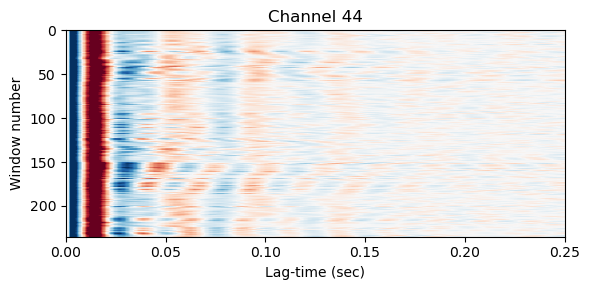

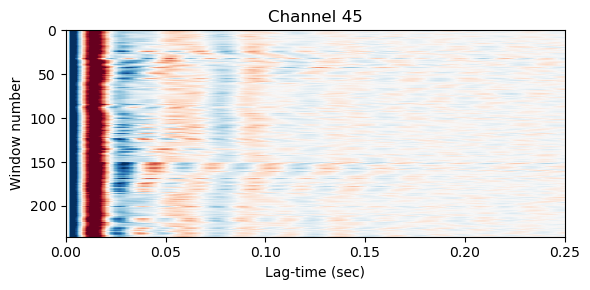

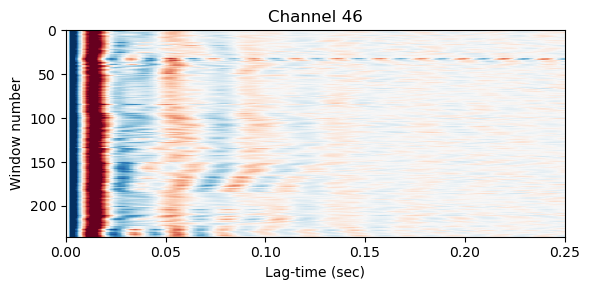

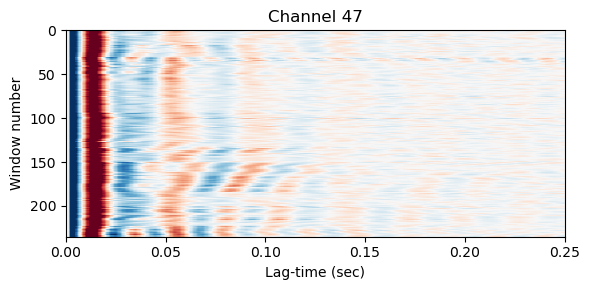

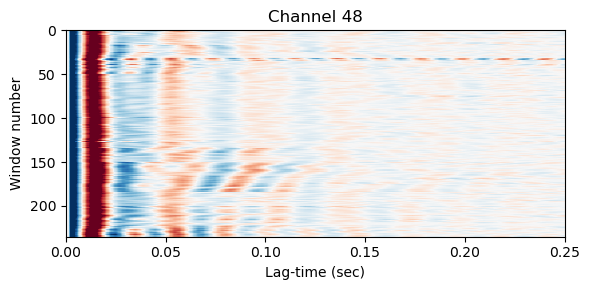

...

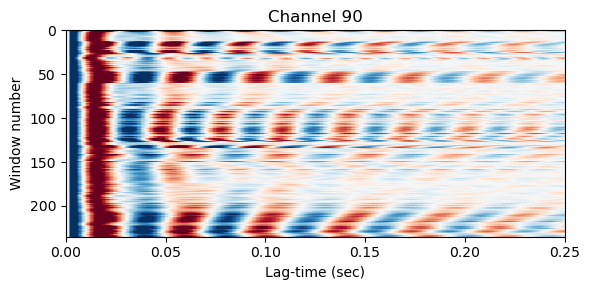

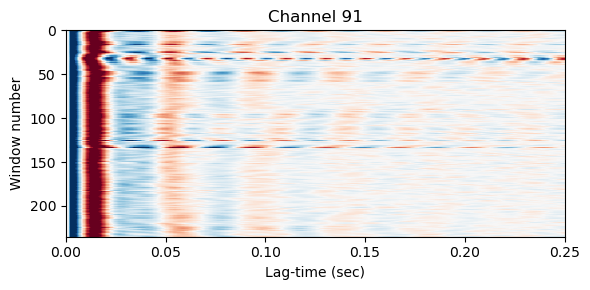

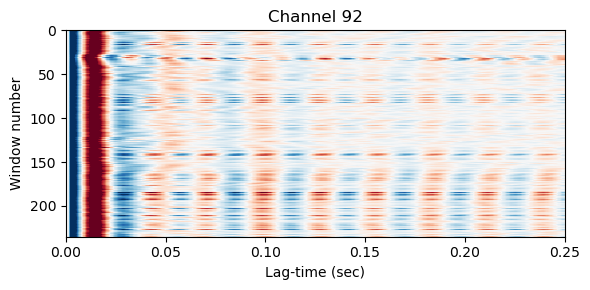

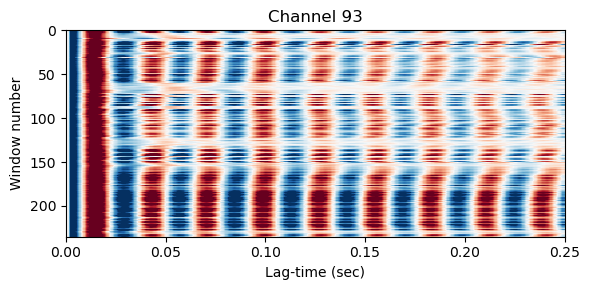

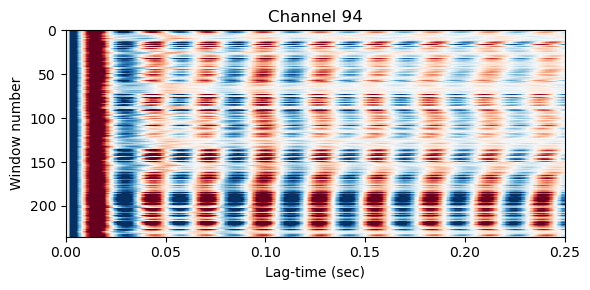

In [15]:
tlag=125
short_ncf=np.zeros((nlocs,nstartf,tlag+1), dtype = np.float32)
print(short_ncf.shape, autocorr.shape)
for chan in range(nlocs):
    chnm=locs[chan]
    for tsp in range(nstartf):
        short_ncf[chan,tsp, : ] =autocorr[chan, tsp, ((n_lag-1)//2):((n_lag-1)//2)+tlag+1].reshape(tlag+1)
        
    #print(np.min(short_ncf[chan]),np.max(short_ncf[chan]))
    plt.figure(figsize=(6,3))
    plt.imshow(short_ncf[chan], extent=[0,tlag/samp,nstartf,0],aspect='auto',vmin=-10**3.5,vmax=10**3.5,cmap = 'RdBu')
    plt.title("Channel "+str(chnm))
    plt.ylabel('Window number')
    plt.xlabel('Lag-time (sec)')
    plt.tight_layout()
    

/tmp/ipykernel_3706944/880391207.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax=plt.subplots(1,4,figsize=(22,3))


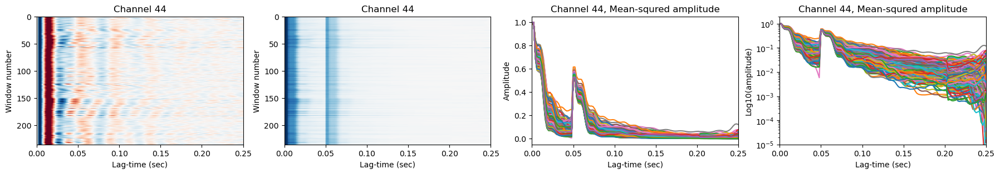

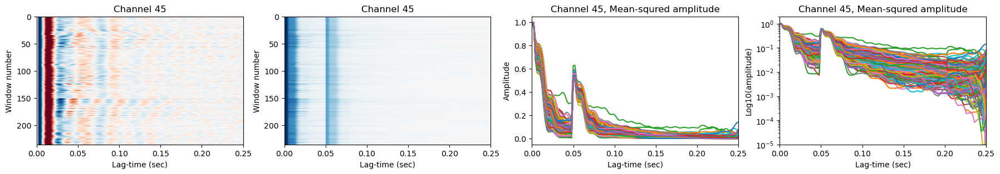

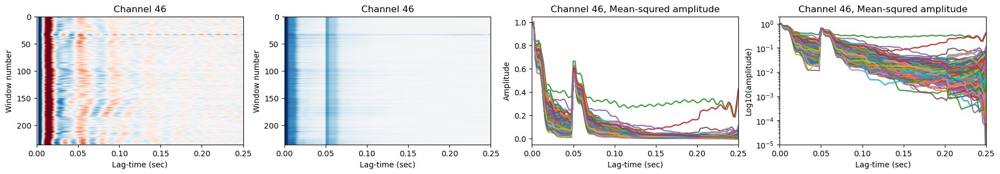

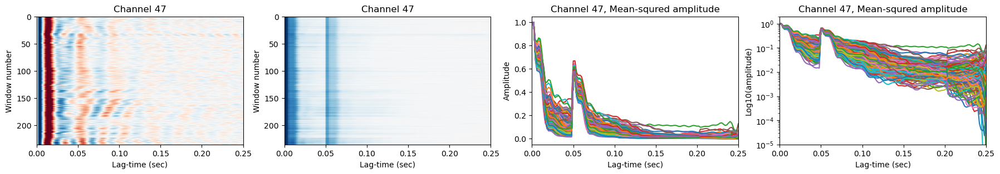

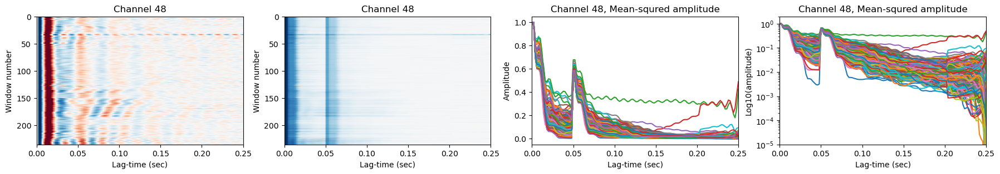

...

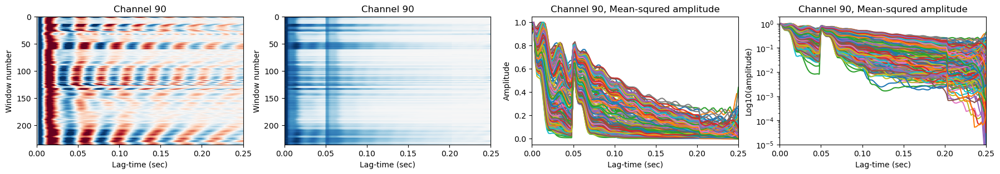

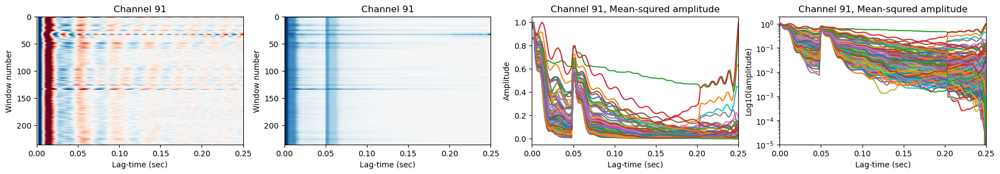

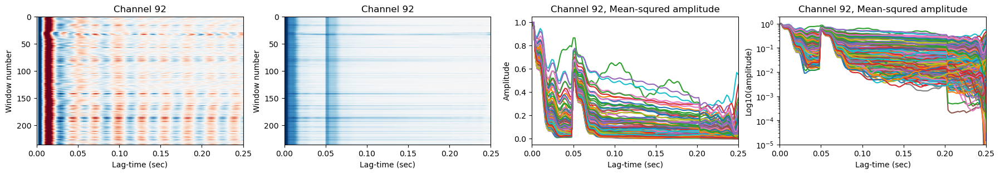

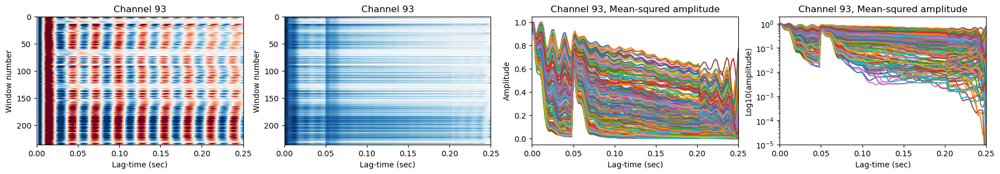

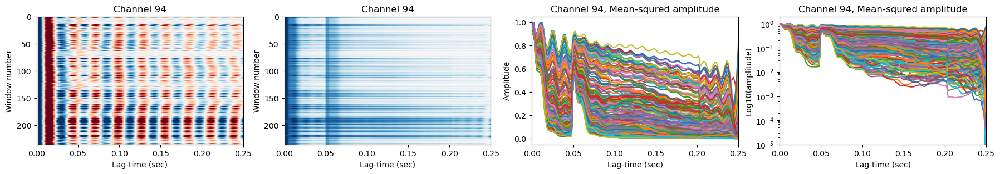

In [16]:
# smooth 
nccomp=1
freq1=25
freq2=50
winlen=0.1  # smoothing window length
dt=1/samp

nwin=nstartf 
num_chunk=nstartf
num_segmts=1
npts_segmt=tlag+1
# Restore calendar time from cc_time array 
win_time=[]

#tcur_temp1 = np.zeros(shape=(num_chunk*num_segmts, npts_segmt))
msv=np.zeros((nlocs, num_chunk*num_segmts, npts_segmt))
ptime=np.arange(0,(tlag+1)/samp,dt)
# get all components average
for chan in range(nlocs):
    chnm=locs[chan]
    for tsp in range(nstartf):
        para = { 'winlen':winlen, 'dt':dt , 'npts':tlag+1}
        msv[chan,tsp]=get_smooth(short_ncf[chan,tsp], para)
        msv[chan,tsp]=msv[chan,tsp]/np.max(msv[chan,tsp])
         
    fig,ax=plt.subplots(1,4,figsize=(22,3))
    ax[0].imshow(short_ncf[chan], extent=[0,tlag/samp,nstartf,0],aspect='auto',vmin=-10**3.5,vmax=10**3.5,cmap = 'RdBu')
    ax[0].set_title("Channel "+str(chnm))
    ax[0].set_ylabel('Window number')
    ax[0].set_xlabel('Lag-time (sec)')
    
    ax[1].imshow(msv[chan], extent=[0,tlag/samp,nstartf,0],aspect='auto',vmin=-1,vmax=1,cmap = 'RdBu')
    ax[1].set_title("Channel "+str(chnm))
    ax[1].set_ylabel('Window number')
    ax[1].set_xlabel('Lag-time (sec)')
    
    ax[2].set_xlim(ptime[0],ptime[-1])
    for k in range(nstartf):
        ax[2].plot( ptime,msv[chan,k,:])
    ax[2].set_title("Channel "+str(chnm)+", Mean-squred amplitude")
    ax[2].set_ylabel('Amplitude')
    ax[2].set_xlabel('Lag-time (sec)') 
    
    ax[3].set_yscale('log')
    ax[3].set_ylim(1e-5,2)
    ax[3].set_xlim(ptime[0],ptime[-1])
    for k in range(nstartf):
        ax[3].plot( ptime,msv[chan,k,:])
    ax[3].set_title("Channel "+str(chnm)+", Mean-squred amplitude")
    ax[3].set_ylabel('Log10(amplitude)')
    ax[3].set_xlabel('Lag-time (sec)')
    

In [17]:
twinbe=np.ndarray((1,1,2))
twinbe[0,0,0]=0.025
twinbe[0,0,1]=0.15

vdist=np.zeros((1))     # station distance
cvel=2.6                # Rayleigh wave velocities over the freqency bands
mfpx=np.zeros(1)        # mean_free_path search array
intby=np.zeros(30)      # intrinsic_b search array


In [18]:
# getting the sum of squared residuals (SSR) between Eobs and Esyn  
SSR_final=np.zeros((len(mfpx),len(intby)))
SSR=np.zeros((nlocs,nwin,1,len(mfpx),len(intby)))

c=cvel
vdist=[0.000001]  # To avoid zero value at denominator
print(twinbe)
for chan in range(nlocs):    
    for ntw in range(nwin):
        data=np.zeros(shape=(1,2,tlag+1))
        data[0,:,:]=msv[chan,ntw]
        #print(data.shape,fmsv_mean[ntw].shape)
        # parameters for getting the sum of squared residuals (SSR) between Eobs and Esyn 
        para={ 'fb':0 , 'vdist':vdist, 'npts': tlag*2, 'dt':dt, 'cvel':c, \
            'mfp':mfpx, 'intb':intby,'twin':twinbe, 'fmsv':data }
        # call function get_SSR
        SSR_final, mfpx, intby = get_SSR(1, para )

        SSR[chan,ntw,0]=SSR_final
print(SSR.shape)

[[[0.025 0.15 ]]]


(51, 235, 1, 1, 30)


In [19]:
def plot_fitting_result(mean_free,intrinsic_b,tt,Eobs,Esyn,fname,dist,twind,fmin,fmax,win_num):
    plt.figure(figsize=(6,2))
    plt.yscale('log', base=10)

    pymax=np.max(Eobs[:-2]*5)
    pymin=10**(-6)
    print(" Channel: %s,", fname, pymin , pymax )
    plt.ylim( pymin , pymax )
    plt.plot( tt, Eobs, "k-", linewidth=1)
    plt.plot( tt, Esyn, "b--", linewidth=1)
    plt.plot([twind[0],twind[0],twind[-1],twind[-1],twind[0]],[pymin, pymax,pymax,pymin,pymin],"r", linewidth=2)

    plt.title("%s @%4.2f-%4.2f Hz, intrinsic b: %.2f, Window no. %d" \
            % ( fname,fmin,fmax,intrinsic_b, win_num))
    plt.xlabel("Lag time (sec)")
    plt.ylabel("Energy density Amp")
    plt.tight_layout()   
    plt.show()
                    

 Channel: %s, 44 1e-06 5.0


/home/kffeng/miniconda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kffeng/miniconda/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


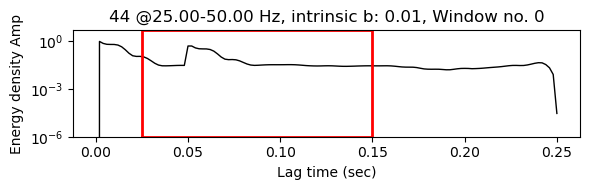

 Channel: %s, 44 1e-06 nan


/home/kffeng/miniconda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kffeng/miniconda/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


ValueError: Axis limits cannot be NaN or Inf

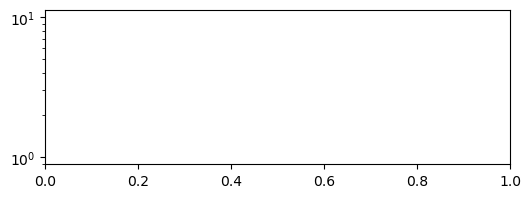

In [20]:
# getting the optimal value from the SSR
result_intb=np.zeros((nlocs,nwin,1))
result_mfp=np.zeros((nlocs,nwin, 1))
intQ=np.zeros((nlocs,nwin,1)) 

Eobs=np.ndarray((1,tlag))
Esyn=np.ndarray((1,tlag))
aa=0
r=np.take(vdist[aa],0) 

fmin=freq1
fmax=freq2
wfcen=2.0*np.pi*((freq1+freq2)/2.0)
for chan in range(nlocs):
    chnm=locs[chan]
    for ntw in range(nwin):

        data=np.zeros(shape=(1,2,tlag+1))
        data[0,:,:]=msv[chan][ntw]
        # parameters for getting optimal value from the sum of squared residuals (SSR) between Eobs and Esyn 
        para={ 'fb':0, 'fmin':fmin, 'fmax':fmax, 'vdist':vdist, 'npts':tlag*2, 'dt':dt, 'cvel':c, 'filenum':aa, \
            'mfp':mfpx, 'intb':intby,'twin':twinbe, 'fmsv':data, 'SSR':SSR[chan][ntw] , 'sta':chnm}
        # call function get_optimal
        result_intb[chan][ntw], result_mfp[chan][ntw], Eobs, Esyn = get_optimal(1,para)
        # plotting fitting results
        #if ntw == 0:
        plot_fitting_result(result_mfp[chan][ntw],result_intb[chan][ntw],ptime, 
                        Eobs,Esyn,chnm,vdist[0],twinbe[0][0],fmin,fmax,ntw)


intQ=wfcen/result_intb


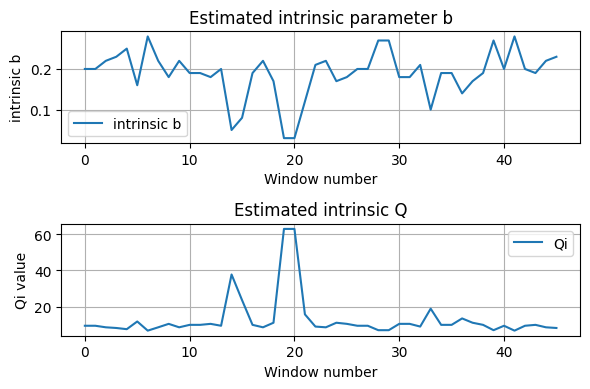

In [ ]:
fig,ax=plt.subplots(2,1,figsize=(6,4))
ax[0].plot(result_intb, label='intrinsic b')
ax[0].legend();ax[0].grid(True)
ax[0].set_title('Estimated intrinsic parameter b')
ax[0].set_xlabel('Window number')
ax[0].set_ylabel('intrinsic b')

ax[1].plot(intQ, label='Qi')
ax[1].legend();ax[1].grid(True)
ax[1].set_title('Estimated intrinsic Q')
ax[1].set_xlabel('Window number')
ax[1].set_ylabel('Qi value')
plt.tight_layout()

## Step 1 --- Calculation of mean-squared (MS) envelopes --> ***Eobs*** 
--> normalized MS envelope is referred to as the observed energy density Eobs 

## Step 2 --- Calculation of synthesized energy densities (*Esyn*) via a grid search

### *The 2-D radiative transfer equation for scalar waves *(Shang and Gao 1988; Sato 1993)*

Assuming isotropic scattering and source radiation in infinite medium to calculate *synthesized energy densities Esyn* :

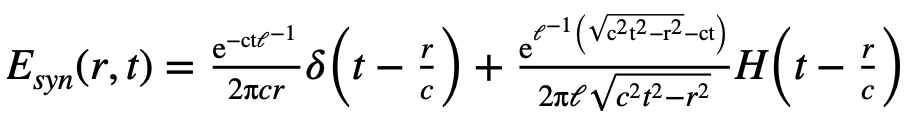

The sum of squared residuals (SSR) between Eobs and Esyn was calculated, and the values of the parameters l and b that minimize SSR through the grid search were determined. 

An energy density with the spatially homogeneous intrinsic absorption is obtained by multiplying e^-bt with the right-hand-side of Equation (1), where **b is intrinsic absorption parameter**

Here i is the number of time windows and j is the number of station pairs. from Hirose et al. (2022) -->

--> 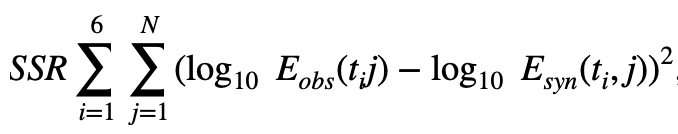

### Step 3 --- Determination of best-fit parameters